# Uncertanity Quantification in Strucuture From Motion


We have number of pictures where each point is a projection of some point from 3d space.
$$
x_{ij} = P_i X_j \, 
$$
$$
i = 1, \ldots, m, \\
j = 1, \ldots, n
$$

Using the pictures we can formulate optimization problem for reconstruction of points $X_i$.

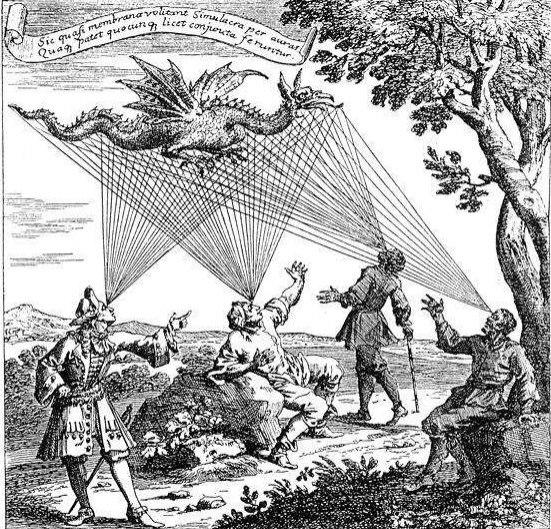

# Optimization problem

$$
E (P, X) = \sum_{i = 1}^m \sum_{j = 1}^n D(x_{ij}, P_i X_j)^2 \rightarrow \min_{X}
$$

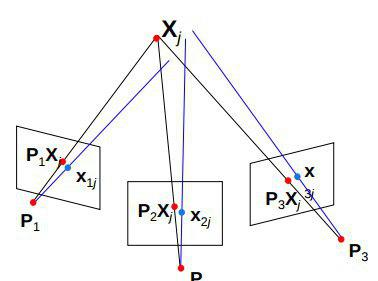|

In [1]:
import cv2 as cv
import matplotlib.pyplot as plt
import os
import pickle
import numpy as np
%matplotlib inline

In [2]:
import sys

In [3]:
#sys.path.pop(1)
dataset = 'bunny_data/'
dir_basis = './'

## Extracting visual features

In [4]:
dir_basis = './' + dataset
dir_masks = dir_basis + 'silhouettes/'
dir_images = dir_basis + 'images/'
dir_proj = dir_basis + 'calib/'

#files = sorted([file for file in os.listdir(dir_basis) if file.split('.')[-2] == 'color' 
#                and file.split('.')[-1] == 'png'])[::20]
files = sorted([file for file in os.listdir(dir_images) if file.split('.')[-1] == 'ppm'])
masks = sorted(os.listdir(dir_masks))

def create_orb_features(dir_basis, files):
    for i, file in enumerate(files):

        filename = dir_images + file
        maskname = dir_masks + masks[i]
        
        if os.path.exists(filename[:-3] + 'pckl'):
            continue

        img = (255 - cv.imread(maskname)) *  cv.imread(filename)
        gray= cv.cvtColor(img,cv.COLOR_BGR2GRAY)
        orb = cv.xfeatures2d.SIFT_create()

        kp, descriptors = orb.detectAndCompute(gray, None)

        temp = [(point.pt, point.size, point.angle, point.response, point.octave, 
            point.class_id, desc) for point, desc in zip(kp, descriptors)]

        with open(filename[:-3] + 'pckl', 'wb') as file:
            pickle.dump(temp, file)

In [5]:
create_orb_features(dir_basis, files)

In [6]:
def deserialize_keypoint(point):
    return cv.KeyPoint(x=point[0][0],y=point[0][1],_size=point[1], _angle=point[2], 
                            _response=point[3], _octave=point[4], _class_id=point[5]), point[6]

In [7]:
FLANN_INDEX_LSH = 6
index_params= dict(algorithm = FLANN_INDEX_LSH,
                   table_number = 6, # 12
                   key_size = 12,     # 20
                   multi_probe_level = 1) #2

# FLANN parameters
FLANN_INDEX_KDTREE = 0
index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
search_params = dict(checks=50)   # or pass empty dictionary

flann = cv.FlannBasedMatcher(index_params,search_params)

In [8]:
flann = cv.FlannBasedMatcher(index_params, {})

In [9]:
def get_keypoints(image_file):
    kp1, desc1 = [], []
    with open(image_file[:-3] + 'pckl', 'rb') as file:
        for entry in pickle.load(file):
            k, d = deserialize_keypoint(entry)
            kp1.append(k)
            desc1.append(d)       
    return kp1, np.array(desc1)

In [10]:
fname1 = dir_images + files[0]
fname2 = dir_images + files[1]
kp1, desc1 = get_keypoints(fname1)
kp2, desc2 = get_keypoints(fname2)

In [11]:
matches = flann.knnMatch(desc1,desc2,k=2)

In [12]:
matchesMask = [[0,0] for i in range(len(matches))]

good = []
pts1 = []
pts2 = []
# ratio test as per Lowe's paper
for i,(m,n) in enumerate(matches):
    if m.distance < 0.8*n.distance:
        matchesMask[i] = [1, 0]
        good.append(m)
        pts2.append(kp2[m.trainIdx].pt)
        pts1.append(kp1[m.queryIdx].pt)

In [13]:
draw_params = {
    'matchColor' : (0,255,0),
    'singlePointColor' : (255,0,0),
    'matchesMask' : matchesMask,
    'flags' : 0
}

In [14]:
img1 = cv.imread(fname1)
img2 = cv.imread(fname2)

In [15]:
img3 = cv.drawMatchesKnn(img1,kp1,img2,kp2,matches,None, **draw_params)

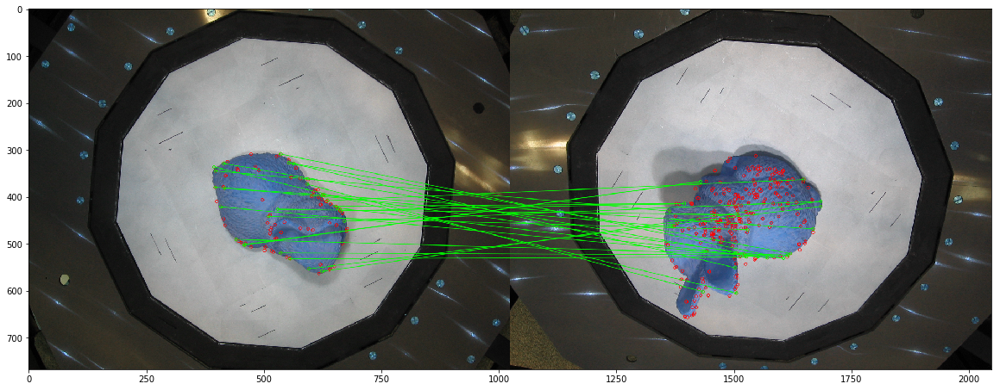

In [16]:
plt.figure(figsize=(20, 10))
plt.imshow(img3)

In [17]:
pts1 = np.int32(pts1)
pts2 = np.int32(pts2)
F, mask = cv.findFundamentalMat(pts1, pts2, cv.FM_RANSAC)
pts1 = pts1[mask.ravel() == 1]
pts2 = pts2[mask.ravel() == 1]

In [18]:
def drawlines(img1,img2,lines,pts1,pts2):
    ''' img1 - image on which we draw the epilines for the points in img2
        lines - corresponding epilines '''
    r,c, _ = img1.shape
    for r,pt1,pt2 in zip(lines,pts1,pts2):
        color = tuple(np.random.randint(0,255,3).tolist())
        x0,y0 = map(int, [0, -r[2]/r[1] ])
        x1,y1 = map(int, [c, -(r[2]+r[0]*c)/r[1] ])
        img1 = cv.line(img1, (x0,y0), (x1,y1), color,1)
        img1 = cv.circle(img1,tuple(pt1),5,color,-1)
        img2 = cv.circle(img2,tuple(pt2),5,color,-1)
    return img1, img2

# Filtering out false positive matches using epipolar geometry

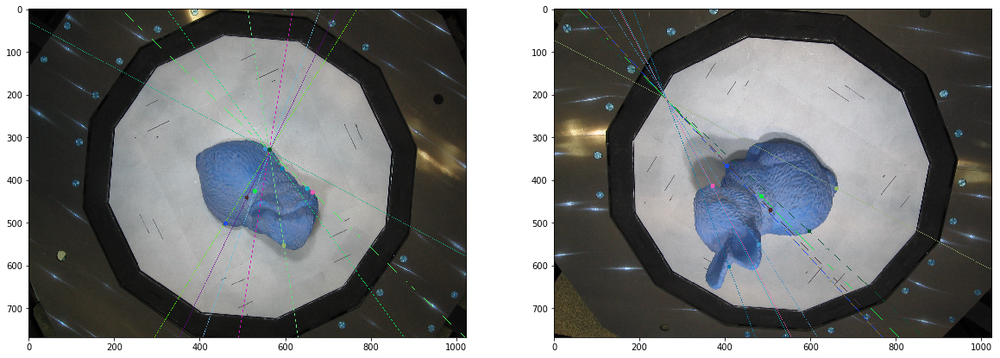

In [19]:
plt.figure(figsize=(20, 10))
lines1 = cv.computeCorrespondEpilines(pts2.reshape(-1,1,2), 2,F)
lines1 = lines1.reshape(-1,3)
img5,img6 = drawlines(img1,img2,lines1,pts1,pts2)
# Find epilines corresponding to points in left image (first image) and
# drawing its lines on right image
lines2 = cv.computeCorrespondEpilines(pts1.reshape(-1,1,2), 1,F)
lines2 = lines2.reshape(-1,3)
img3,img4 = drawlines(img2,img1,lines2,pts2,pts1)
plt.subplot(121), plt.imshow(img5)
plt.subplot(122), plt.imshow(img3)
plt.show()

In [20]:
K = np.array([
    [585.0, 0., 320],
    [0., 585, 240],
    [0, 0, 1]
])

In [21]:
from itertools import product

def find_correspondences(files):
    # TODO: Save fundamental matrices
    # How to take out 
    
    fname0 = files[0]
    kp0, desc0 = get_keypoints(fname0)
    pts_correspondence = {}

    for i in range(len(files))[1:]:

        fname1 = files[i]
        kp1, desc1 = get_keypoints(fname1)

        flann = cv.FlannBasedMatcher(index_params, search_params)
        matches = flann.knnMatch(desc0,desc1,k=2)

        matchesMask = [[0,0] for i in range(len(matches))]

        good = []
        pts1 = []
        pts2 = []

        # ratio test as per Lowe's paper
        for j, p in enumerate(matches):
            try:
                m, n = p
            except:
                continue
            if m.distance < 0.8 * n.distance:
                matchesMask[j] = [1, 0]
                good.append(m)
                pts2.append(kp1[m.trainIdx])
                pts1.append(kp0[m.queryIdx])

        pts1_coord = np.int32([kp.pt for kp in pts1])
        pts2_coord = np.int32([kp.pt for kp in pts2])

        F, mask = cv.findFundamentalMat(pts1_coord, pts2_coord, cv.FM_RANSAC)
        
        pts1 = np.array(pts1)[mask.ravel() == 1]
        pts2 = np.array(pts2)[mask.ravel() == 1]
        
        pts1_coord = pts1_coord[mask.ravel() == 1]
        pts2_coord = pts2_coord[mask.ravel() == 1]
        
        E, mask = cv.findEssentialMat(pts1_coord, pts2_coord, K)
        T = np.eye(4)
        _, R, t, _ = cv.recoverPose(E, pts1_coord, pts2_coord, K)
        T[:3, :3] = R
        T[:-1, -1] = t.reshape(-1)
        
        pts_correspondence[(i-1, i)] = (pts1.copy(), pts2.copy(), T.copy())

        kp0, desc0 = kp1, desc1
        
    return pts_correspondence

pts_correspondence = find_correspondences([dir_images + file for file in files])

# Building 3D Points tracks

In [22]:
tracks = [[True, 0, [pt1, pt2]] for pt1, pt2 in zip(*pts_correspondence[(0, 1)][:-1])]

In [23]:
for i in range(1, len(files) - 1):
    
    if i % 50 == 0:
        print(i)
        print(len(tracks))
        
    taken_points = np.zeros_like(pts_correspondence[(i, i + 1)][0], dtype=bool)
    
    for track in tracks:
        
        has_match = False
        kp = track[-1][-1]
        
        if track[0] == False:
            continue

        for j, kp1 in enumerate(pts_correspondence[(i, i + 1)][0]):
            if np.linalg.norm(np.array(kp.pt) - np.array(kp1.pt)) < kp.size:
                taken_points[j] = True
                if has_match:
                    continue
                has_match = True
                track[-1].append(pts_correspondence[(i, i + 1)][1][j])
        
        track[0] = has_match
    
    for kp_index in np.where(taken_points == False)[0]:
        tracks.append([True, i, [
            pts_correspondence[(i, i + 1)][0][kp_index],
            pts_correspondence[(i, i + 1)][1][kp_index]
        ]])

In [24]:
lengths = [len(track[-1]) for track in tracks]

In [25]:
lengths[np.argmax(lengths)]

8

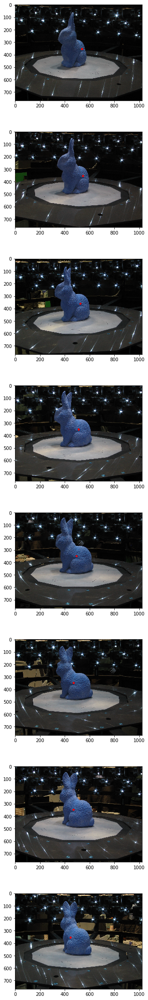

In [26]:
k = np.argmax(lengths)
plt.figure(figsize=(5, len(tracks[k][-1]) * 5))
for j, kp in enumerate(tracks[k][-1]):
    plt.subplot(len(tracks[k][-1]), 1, j + 1)
    i = tracks[k][1]
    im = cv.imread(dir_images + files[i + j])
    cv.circle(im, tuple(np.array(kp.pt, dtype=np.int32)), 5, (255, 0, 0), 5)
    plt.imshow(im)

In [27]:
lengths = [len(track[2]) for track in tracks]
# first entry - finish flag (auxilary stuff)
# second entry - the first frame where the point appears
# third entry - list of keypoints on subsequent images

# Rough triangulation of points

In [28]:
succesfull_triangulations = {}

for i, track in enumerate(tracks):
    
    if len(track[-1]) < 3:
        continue
    
    image_coords = np.array([kp.pt for kp in tracks[i][-1]])
    image_indices = np.arange(tracks[i][1], tracks[i][1] + len(tracks[i][-1]))
    
    triangulations = []
    
    for j in range(len(image_indices) - 1):
        
        P = np.loadtxt(dir_proj + files[image_indices[j]].split('.')[0] + '.txt', skiprows=1) 
        P_dash = np.loadtxt(dir_proj + files[image_indices[j + 1]].split('.')[0] + '.txt', skiprows=1)
        
        world_point = cv.triangulatePoints(
            P, P_dash,
            image_coords[j].reshape(2, -1), image_coords[j + 1].reshape(2, -1)
        )
        
        world_point = cv.convertPointsFromHomogeneous(world_point.reshape(-1, 4))
        triangulations.append(world_point)
        
    triangulation = np.array(triangulations).mean(axis=0)
    world_point = cv.convertPointsToHomogeneous(triangulation).reshape(-1)
    
    for j in range(len(image_indices)):
        
        P = np.loadtxt(dir_proj + files[image_indices[j]].split('.')[0] + '.txt', skiprows=1)
        
        rep = cv.convertPointsFromHomogeneous(
            (P @ world_point).reshape(-1, 3)
        ).reshape(-1)
        
        if np.linalg.norm(rep - image_coords[j]) > 10:
            break
    else:
        succesfull_triangulations[i] = triangulation.reshape(-1)

In [29]:
len(succesfull_triangulations.keys())

670

# Bundle adjustment

In [32]:
tracks_successfull = [tracks[i] for i in succesfull_triangulations]

In [33]:
points_2d = []
points_ind = []
camera_ind = []
sigmas = []

for i, track in enumerate(tracks_successfull):
    for j, kp in enumerate(track[-1]):
        points_ind.append(i)
        camera_ind.append(track[1] + j)
        points_2d.append(kp.pt)
        sigmas.append(kp.size)
        
points_2d = np.array(points_2d)
point_indices = np.array(points_ind, dtype=np.uint32)
camera_indices = np.array(camera_ind, dtype=np.uint32)
sigmas = np.array(sigmas)

points_3d = np.array([succesfull_triangulations[i] for i in succesfull_triangulations])
n_points = len(points_3d)

In [34]:
projectors = []
for name in sorted(os.listdir(dir_basis + 'calib/')):
    projectors.append(np.loadtxt(dir_basis +'calib/' + name, skiprows=1))
projectors = np.array(projectors)
n_cameras = len(projectors)

In [35]:
def project(points, projectors):
    projected = np.matmul(projectors[camera_indices], 
                          np.hstack((points[point_indices], 
                                     np.ones(len(point_indices)).reshape(-1, 1)))[:, :, np.newaxis])
    projected = np.squeeze(projected)
    projected = projected[:, :2] / projected[:, -1][:, None]
    return projected

In [36]:
def fun(params, n_cameras, n_points, camera_indices, point_indices, points_2d, projectors, sigmas):
    """Compute residuals.
    
    `params` contains camera parameters and 3-D coordinates.
    """
    points_3d = params.reshape((n_points, 3))
    points_proj = project(points_3d[point_indices], projectors[camera_indices])
    return ((points_proj - points_2d) / np.sqrt(sigmas)[:, None]).ravel()

In [37]:
from scipy.sparse import lil_matrix

In [38]:
def bundle_adjustment_sparsity(n_cameras, n_points, camera_indices, point_indices):
    m = camera_indices.size * 2
    n = n_points * 3
    A = lil_matrix((m, n), dtype=int)

    i = np.arange(camera_indices.size)

    for s in range(3):
        A[2 * i, point_indices * 3 + s] = 1
        A[2 * i + 1, point_indices * 3 + s] = 1
    
    return A

In [39]:
%matplotlib inline
import matplotlib.pyplot as plt

In [40]:
x0 = points_3d.ravel()

In [41]:
f0 = fun(x0, n_cameras, n_points, camera_indices, point_indices, points_2d, projectors, sigmas)

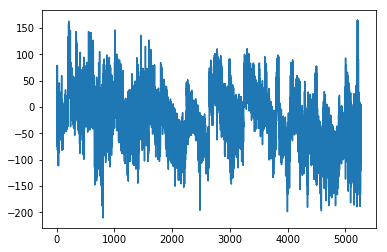

In [42]:
plt.plot(f0)

In [43]:
A = bundle_adjustment_sparsity(n_cameras, n_points, camera_indices, point_indices)

In [44]:
import time
from scipy.optimize import least_squares

In [45]:
t0 = time.time()
res = least_squares(fun, x0, jac_sparsity=A, verbose=2, x_scale='jac', ftol=1e-8, method='trf',
                    args=(n_cameras, n_points, camera_indices, point_indices, points_2d, projectors, sigmas))
t1 = time.time()

   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0              1         9.5535e+06                                    1.27e+05    
       1              5         9.5411e+06      1.24e+04       5.46e+00       1.40e+05    
       2              6         9.5395e+06      1.65e+03       1.29e+00       1.44e+05    
       3              7         9.5392e+06      3.30e+02       3.19e-01       1.45e+05    
       4              8         9.5391e+06      7.73e+01       7.96e-02       1.45e+05    
       5              9         9.5391e+06      1.90e+01       1.99e-02       1.45e+05    
       6             10         9.5391e+06      4.73e+00       4.97e-03       1.45e+05    
       7             11         9.5391e+06      1.18e+00       1.24e-03       1.45e+05    
       8             12         9.5391e+06      2.95e-01       3.11e-04       1.45e+05    
       9             13         9.5391e+06      7.38e-02       7.76e-05       1.45e+05    

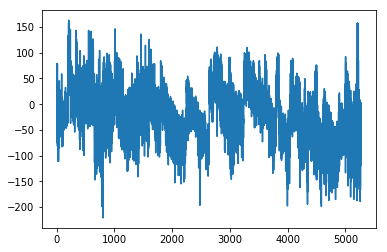

In [46]:
plt.plot(res.fun)

# Result

In [47]:
pts = res.x.reshape(-1, 3)

In [76]:
import plotly.graph_objs as go
from  plotly.offline import iplot,init_notebook_mode

def get_plot(x, y, z):
    init_notebook_mode(False)
    trace1 = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=1.0,
            line=dict(
                width=0.5
            ),
            opacity=0.8
        )
    )
    
    layout = go.Layout(
                    scene = dict(
                    xaxis = dict(
                        nticks=4,),
                    yaxis = dict(
                        nticks=4,),
                    zaxis = dict(
                        nticks=4,),),
                    width=700,
                    margin=dict(
                    r=20, l=10,
                    b=10, t=10)
                  )
    fig = go.Figure(data=[trace1], layout=layout)

    return iplot(fig, filename='bla')

cloud = np.array([succesfull_triangulations[key] for key in succesfull_triangulations])
get_plot(pts[:, 0], pts[:, 1], pts[:, 2])

# Estimating uncertainty

## Measurement uncertainty:

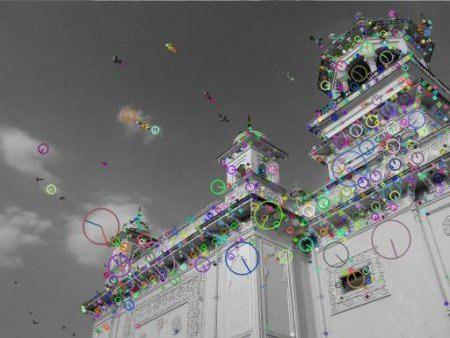

Covariance matrix of a result can be estimated by $J^T \Sigma J$

In [71]:
jacobian = res.jac
coordwise_sigmas = np.zeros(2 * len(sigmas))
coordwise_sigmas[2 * np.arange(len(sigmas))] = 1 / sigmas
coordwise_sigmas[2 * np.arange(len(sigmas)) + 1] = 1 / sigmas
uncertainties = jacobian.toarray().T @ np.diag(coordwise_sigmas) @ jacobian.toarray()

In [77]:
def get_plot(x, y, z, cov_x, cov_y, cov_z):
    init_notebook_mode(False)
    trace1 = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=4.0,
            line=dict(
                width=2,
                color=np.sqrt(cov_x ** 2 + cov_y ** 2 + cov_z ** 2)
            ),
            color=np.sqrt(cov_x ** 2 + cov_y ** 2 + cov_z ** 2),
            opacity=0.8,
            colorbar=dict(title="Variance")
        )
    )
    
    layout = go.Layout(
                    scene = dict(
                    xaxis = dict(
                        nticks=4,),
                    yaxis = dict(
                        nticks=4,),
                    zaxis = dict(
                        nticks=4,),),
                    width=700,
                    margin=dict(
                    r=20, l=10,
                    b=10, t=10),
                  )
    fig = go.Figure(data=[trace1], layout=layout)

    return iplot(fig, filename='bla')


conv = np.diag(uncertainties).reshape(-1, 3)
get_plot(pts[:, 0], pts[:, 1], pts[:, 2], conv[:, 0], conv[:, 1], conv[:, 2])

In [73]:
building = np.load('building.npy')

In [78]:
import plotly.graph_objs as go
from  plotly.offline import iplot,init_notebook_mode

def get_plot(x, y, z):
    init_notebook_mode(False)
    trace1 = go.Scatter3d(
        x=x,
        y=y,
        z=z,
        mode='markers',
        marker=dict(
            size=0.05,
            line=dict(
                width=0.5
            ),
            opacity=0.8
        )
    )
    
    layout = go.Layout(
                    scene = dict(
                    xaxis = dict(
                        nticks=4,),
                    yaxis = dict(
                        nticks=4,),
                    zaxis = dict(
                        nticks=4,),),
                    width=700,
                    margin=dict(
                    r=20, l=10,
                    b=10, t=10)
                  )
    fig = go.Figure(data=[trace1], layout=layout)

    return iplot(fig, filename='bla')

cloud = np.array([succesfull_triangulations[key] for key in succesfull_triangulations])
get_plot(building[:, 0], building[:, 1], building[:, 2])